In [10]:
import numpy as np
import os
from PIL import Image
import cv2
import colorcet as cc

In [11]:
TARGET_FOLDER = '../../ims/iNat_pending/sq2'
COLORSHIFT = True # False, True, or float E [0,1]
VERSION = 2 # 1 or 2

sdir = os.getcwd()
os.chdir(TARGET_FOLDER)
# get list of files in directory
flist = [f for f in os.listdir('.') if f.startswith("DSC")]
flist

['DSC01025.JPG',
 'DSC01026.JPG',
 'DSC01027.JPG',
 'DSC01028.JPG',
 'DSC01029.JPG',
 'DSC01030.JPG',
 'DSC01031.JPG',
 'DSC01032.JPG',
 'DSC01033.JPG',
 'DSC01034.JPG']

In [12]:
im = 0*cv2.imread(flist[0],cv2.IMREAD_COLOR)
if VERSION==1:
    hsv_part = 255*np.ones(im.shape).astype('uint8')
im = im.astype('float64')

for n,f in enumerate(flist):
    if not COLORSHIFT:
        img = cv2.imread(f,cv2.IMREAD_COLOR).astype('float64')/255/len(flist)
        im += img
    else:
        img = cv2.imread(f,cv2.IMREAD_GRAYSCALE).astype('float64')/255/len(flist)
        if VERSION==1:
            img = np.stack([img,img,img],axis=-1)
            hsv_part[:,:,0] = (255*n/len(flist)) # still uint8
            im += img*cv2.cvtColor(hsv_part.astype('uint8'), cv2.COLOR_HSV2BGR).astype('float64')/255
        elif VERSION==2:
            rgba_cmap = cc.cm['colorwheel'](int(255*n/len(flist)))
            #rgba_cmap = cc.cm['isolum'](int(255*n/len(flist)))
            #rgba_cmap = cc.cm['rainbow'](int(255*n/len(flist)))
            cmap = (rgba_cmap[2], rgba_cmap[1], rgba_cmap[0])
            im += np.stack([img*cmap[0],img*cmap[1],img*cmap[2]],axis=-1)
        else:
            raise
if COLORSHIFT:
    lab = cv2.cvtColor((255*im).astype('uint8'), cv2.COLOR_BGR2LAB)
    lab[:,:,0] -= lab[:,:,0].min()
    lab[:,:,0] = ( lab[:,:,0].astype(float) * 255 / lab[:,:,0].max() ).round().astype(int)
    for layer in 1,2:
        lab_layer = lab[:,:,layer].astype('float')
        lab_layer -= lab_layer.mean()
        # for whatever reason this performed poorly:
        #lab_layer -= (lab_layer*lab[:,:,0]).sum()/lab[:,:,0].sum() 
        lab_layer = 127.5*lab_layer/abs(lab_layer).max()+127.5
        lab_layer = lab_layer.round().astype('uint8')
        lab[:,:,layer] = lab_layer
    img = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
    cv2.imwrite(f'mergedim{VERSION}.png',img)
else:
    cv2.imwrite(f'mergedim{VERSION}.png',(255*im).astype('uint8'))
os.chdir(sdir)

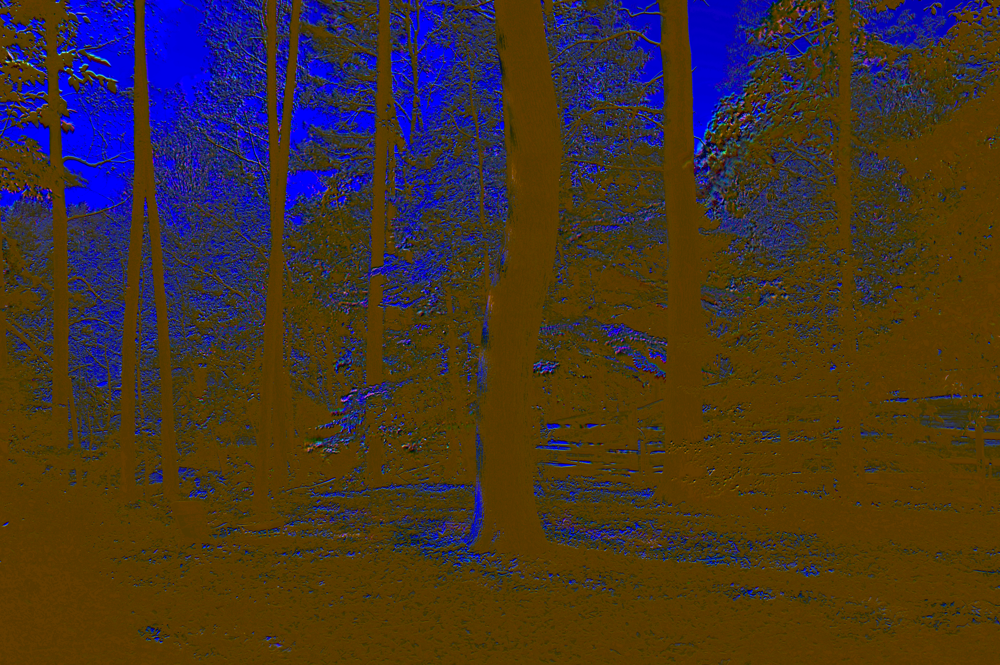

In [19]:
from PIL import Image

im = Image.fromarray(img)
im
#cv2.imwrite('mergedim-v5.png',(255*im).astype('uint8'))
    #print(l.min(), np.median(l), l.mean(), l.max())

In [ ]:
# img = Image.open('DSC00994.JPG')
# img
# # from matplotlib import image
# # from matplotlib import pyplot
# # # load image as pixel array
# # image = image.imread('kolala.jpeg')
# # # summarize shape of the pixel array
# # print(image.dtype)
# # print(image.shape)
# # # display the array of pixels as an image
# # pyplot.imshow(image)
# # pyplot.show()